In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import pandas as pd
import anndata
import scvelo as scv
import scanpy as sc

from scipy.sparse import csr_matrix
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.neighbors import kneighbors_graph
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.axes._axes import _log as matplotlib_axes_logger
from RnaVeloDataset import RnaVeloDataset
# from symsimDataset import SymsimBifur, SymsimTree, SymsimBranch, SymsimLinear, SymsimCycle

from symsimDataset_me import SymsimBifur, SymsimBifurNoisy, SymsimTree, SymsimTreeNoisy

from realDataset import realDataset
from unsupervised_loss import UnsupervisedLoss

import torch
import torch.nn.functional as F
import torch.nn as nn
from sklearn.metrics import roc_auc_score
from torch_geometric.data import DataLoader
from model.BaseModel import BaseModel
from sklearn.metrics import mean_squared_error
from model.autoencoder import AutoEncoder

from model.mymodel import MyModel, GraphSAGEModel, FCModel, veloModel, DiffusionModel


from math import sqrt
import scprep
import utils
import backbone

from torch_geometric.data import Data

In [2]:
dataBifur = SymsimBifur()
dataTree = SymsimTree()
# datalinear = SymsimLinear()
dataDyngen = RnaVeloDataset()
dataReal = realDataset()
dataTreeNoisy = SymsimTreeNoisy()


# pruning better than mst


In [6]:
data = dataTree[0]

t = np.arange(1,10)
# dataset for training
train_mask = list(t) + list(t+10) + list(t+20) + list(t+30) + list(t+40) + list(t+50) + list(t+60) + list(t+70) + list(t+80) + list(t+90)

# dataset for validation
val_mask = [10*i for i in range(10)]

In [96]:
for data in DataLoader(dataTreeNoisy[0,1]):
    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    X = data.x.numpy()
    y = pt.detach().numpy().squeeze()
    y = (y - np.min(y)) / (np.max(y) - np.min(y))
    print(y)
    X_pca = utils.pca_op(X, n_comps=30, standardize=False)
    randwk = backbone.random_walk(X_pca, y, t_max = 10000, i_max = 300, k = 5)
    seg = backbone.segmentation(randwk, X_pca[:,:4], cell_backbone=None, wind_size = 20, step = 5, y = y)
    # seg_pca = utils.pca_op(seg['seg_features'], n_comps=30, standardize=False)
    seg_pca = seg['seg_features']
    print(seg_pca.shape)
    conn, G = backbone.nearest_neighbor(seg_pca, k = 20)
    break

[0.03790813 0.26938215 0.23386921 0.19137171 0.21598676 0.07592709
 0.15005629 0.12549505 0.1471269  0.22758706 0.17585236 0.15456797
 0.15623972 0.15543039 0.10526766 0.12582149 0.13648523 0.08980533
 0.21376798 0.02374336 0.11771221 0.12456492 0.0509685  0.16492453
 0.         0.04304418 0.07657962 0.05860985 0.09746095 0.02312434
 0.06965457 0.01045849 0.23099898 0.09751049 0.18663764 0.15392151
 0.29444376 0.13986686 0.28238407 0.2969651  0.11341328 0.18217157
 0.12873021 0.28076223 0.25717744 0.24758424 0.27600607 0.2792822
 0.27476448 0.21432713 0.26241863 0.24817297 0.18659167 0.22618937
 0.34448817 0.32476792 0.36826468 0.23092735 0.29389495 0.33275387
 0.30553123 0.3103241  0.33272    0.3395289  0.31664222 0.36415213
 0.24292466 0.3409519  0.3322642  0.3268249  0.2735104  0.3051385
 0.30132604 0.24714448 0.33600327 0.32491118 0.35230985 0.27137536
 0.37761128 0.28506544 0.32023734 0.31132728 0.28022552 0.26651728
 0.4121367  0.49803406 0.34023058 0.3544702  0.5577494  0.511849

ValueError: Expected 2D array, got 1D array instead:
array=[].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [98]:
# Use segments rather than original single cell data, much denser, have as many segments as possible. higher probability to pass through the small branches. connection of random walk further provide connection information that constraint the mst construction.
# a segment is a smoothed version of cell data, in theory, better preserve the small branches while eliminate erroneous edges
results = backbone.backbone_finding(data, n_randwk = 500, window_size = 10, step_size = 5, n_neighs = 20, resolution = 0.3, style = 'tree', threshold = 0)


running Leiden clustering
finished
number of clusters:  8
cell assignment
[0 1 2 3 4 5 6 7]
write in results


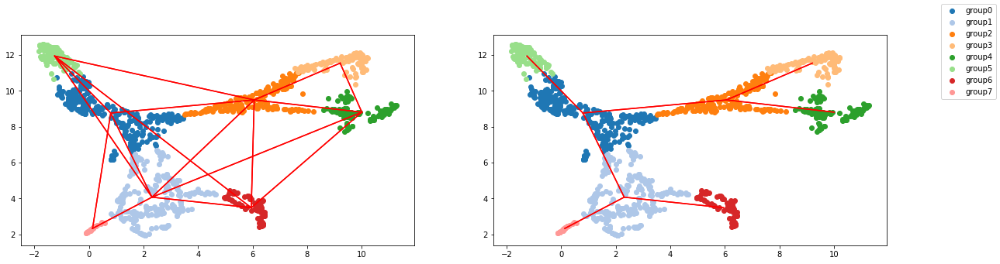

In [99]:
backbone.plot_backbone(results, version = 'segment', figsize = (20,5))

[ 0.  1.  2.  3.  4.  5.  6.  7. inf]
[[-5.926398, -10.774018], [7.012095, -1.0252907], [-4.8193593, -2.11534], [-8.192617, 0.6021323], [-5.67567, 8.301167], [-5.2050323, -7.039857], [-0.9502982, 0.36962578], [8.091801, -5.1712704]]


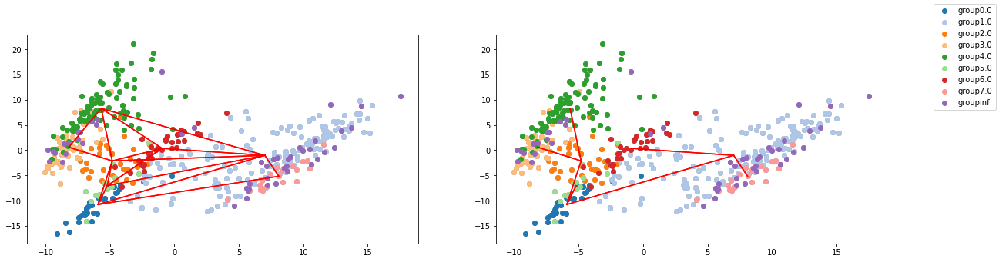

In [100]:
backbone.plot_backbone(results, version = 'cell', figsize = (20,5))

# We cannot prove that our method out perform leiden on pca

running Leiden clustering
finished
8


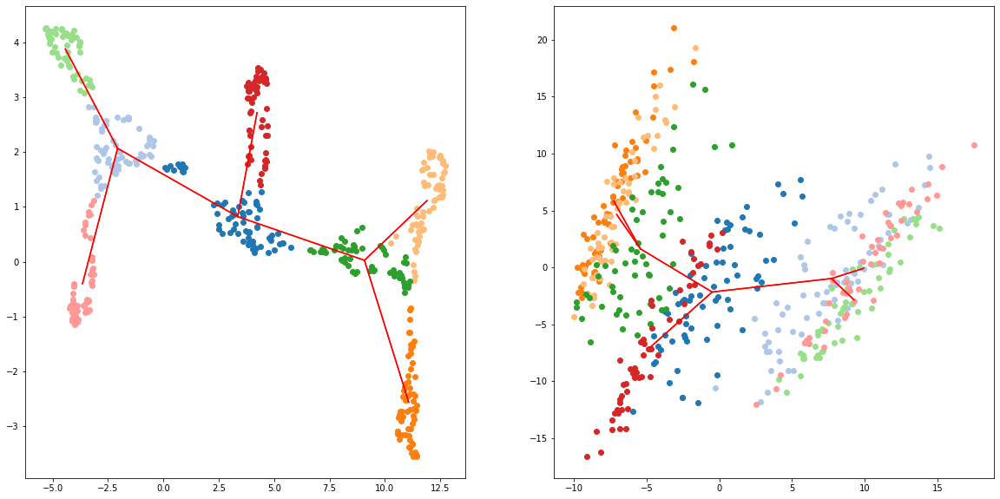

In [31]:
import umap
import networkx as nx
Umap = umap.UMAP(n_components=2)
data = dataTreeNoisy[0]
X = data.x.numpy()
X_pca = utils.pca_op(X, n_comps=30,standardize=False)
conn, G = backbone.nearest_neighbor(X, k = 15)
groups, n_clust = backbone.leiden(conn, resolution=0.9)
print(n_clust)
X_umap = Umap.fit_transform(X)

mean_cluster = [[] for x in range(n_clust)]
mean_cluster2 = [[] for x in range(n_clust)]

fig = plt.figure(figsize = (20,10))
ax1, ax2 = fig.subplots(1,2)
cmap = plt.get_cmap('tab20')
for i, cat in enumerate(np.unique(groups)):
    idx = np.where(groups == cat)[0]
    cluster = ax1.scatter(X_umap[idx,0], X_umap[idx,1], color = cmap(i), cmap = 'tab20')
    cluster.set_label("group"+str(cat))
    mean_cluster[int(cat)] = [np.mean(X_umap[idx,0]), np.mean(X_umap[idx,1])] 
    mean_cluster2[int(cat)] = np.mean(X_pca[idx,:], axis = 0)

for i, cat in enumerate(np.unique(groups)):
    idx = np.where(groups == cat)[0]
    cluster = ax2.scatter(X_pca[idx,0], X_pca[idx,1], color = cmap(i), cmap = 'tab20')
    cluster.set_label("group"+str(cat))

mst = np.zeros((n_clust,n_clust))

for i in range(n_clust):
    for j in range(n_clust):
        mst[i,j] = np.linalg.norm(np.array(mean_cluster2[i]) - np.array(mean_cluster2[j]), ord = 2)

G = nx.from_numpy_matrix(-mst)
T = nx.maximum_spanning_tree(G, weight = 'weight', algorithm = 'kruskal')
T = nx.to_numpy_matrix(T)

conn = T 

for i in range(conn.shape[0]):
    for j in range(conn.shape[1]):
        if conn[i,j] != 0:
            ax1.plot([mean_cluster[i][0], mean_cluster[j][0]], [mean_cluster[i][1], mean_cluster[j][1]], 'r-')
            ax2.plot([mean_cluster2[i][0], mean_cluster2[j][0]], [mean_cluster2[i][1], mean_cluster2[j][1]], 'r-')

# Benchmark with diffusion pseudo-time

In [3]:
Path = "./Linear_symsim_tree_bifur_noisy.pt"

device = torch.device('cpu')
model_fc = FCModel(dataBifur.num_features, device, hidden1=256, hidden2=128, dropout1=0.4, dropout2=0.2).to(device)
model_fc.load_state_dict(torch.load(Path, map_location=torch.device('cpu')))
model_fc.eval()

FCModel(
  (lin1): Linear(in_features=300, out_features=256, bias=True)
  (lin2): Linear(in_features=256, out_features=128, bias=True)
  (lin3): Linear(in_features=128, out_features=1, bias=True)
)

In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
Path = "./Diffusion_symsim_tree_bifur_trifur_without_noise.pt"
# model = DiffusionModel(300, hidden1 = 256, \
                    #    hidden2 = 128, max_diffusion = 8, include_reversed = True, device = device).to(device)
model = DiffusionModel(dataBifur.num_features, hidden1 = 128, hidden2 = 64, max_diffusion = 6, include_reversed = True, device = device, dropout1=0.4, dropout2=0.2).to(device)

model.load_state_dict(torch.load(Path, map_location=torch.device('cpu')))
model.eval()

DiffusionModel(
  (conv1): GraphDiffusion (300 -> 128)
  (conv2): GraphDiffusion (128 -> 64)
  (lin): Linear(in_features=64, out_features=1, bias=True)
)

## True count
### diffusion pseudo-time

pearson corr: 0.8467313 , kendall tau: 0.6950210759150286
pearson corr: 0.9645746 , kendall tau: 0.8060348065606612
pearson corr: 0.9332292 , kendall tau: 0.7190601393931806
pearson corr: 0.9565089 , kendall tau: 0.8394891699010893
pearson corr: 0.9421974 , kendall tau: 0.732548725011477
pearson corr: 0.94469994 , kendall tau: 0.7539115809571978
pearson corr: 0.96606845 , kendall tau: 0.7991235758106925
pearson corr: 0.97876376 , kendall tau: 0.894428446225116
pearson corr: 0.97201633 , kendall tau: 0.8524268603146782
pearson corr: 0.9720776 , kendall tau: 0.8989190768331874


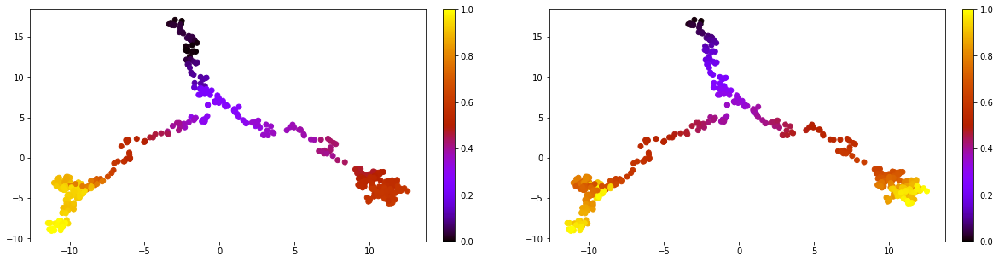

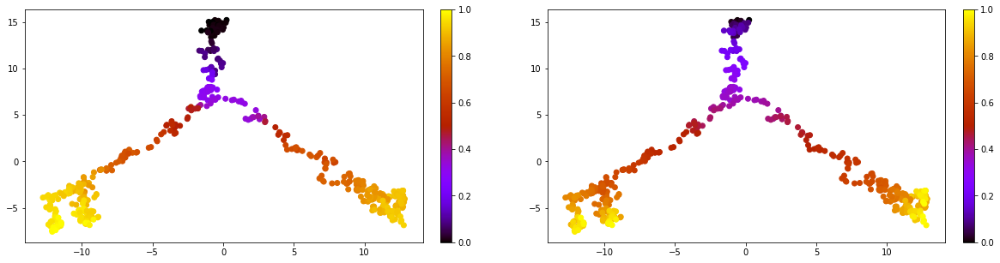

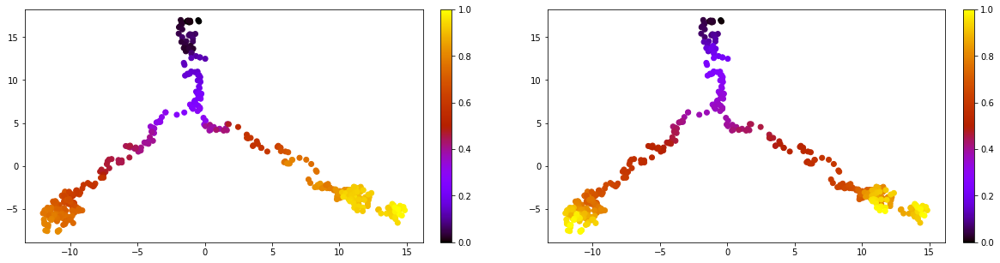

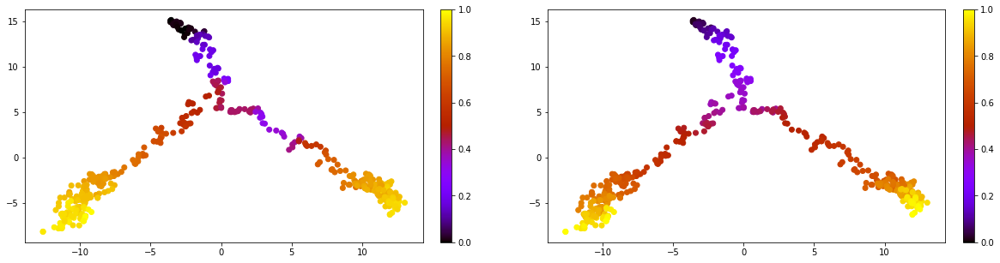

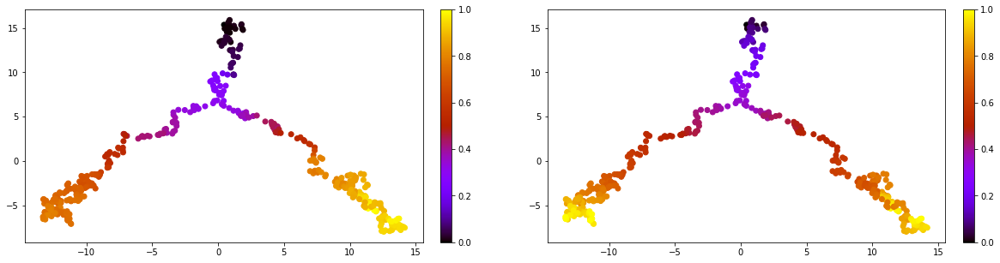

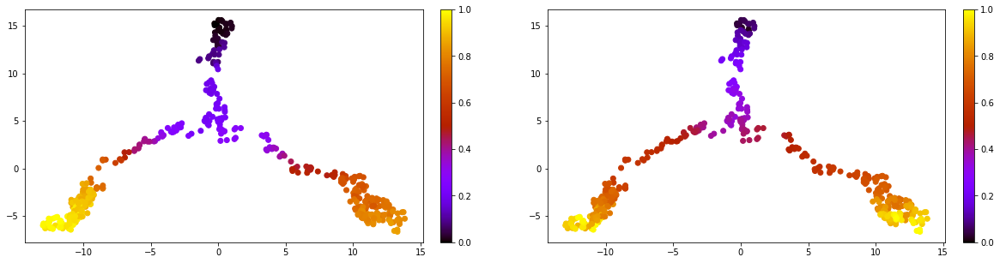

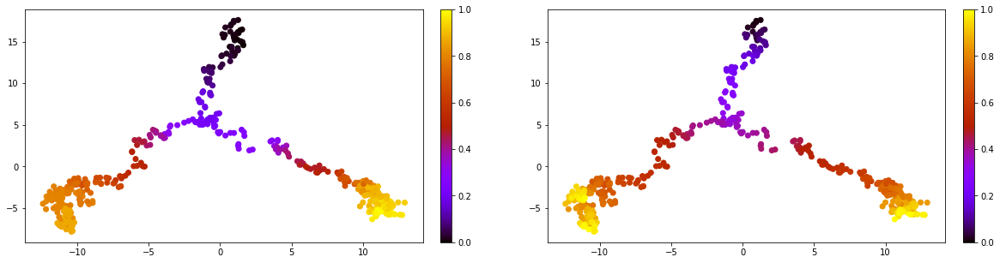

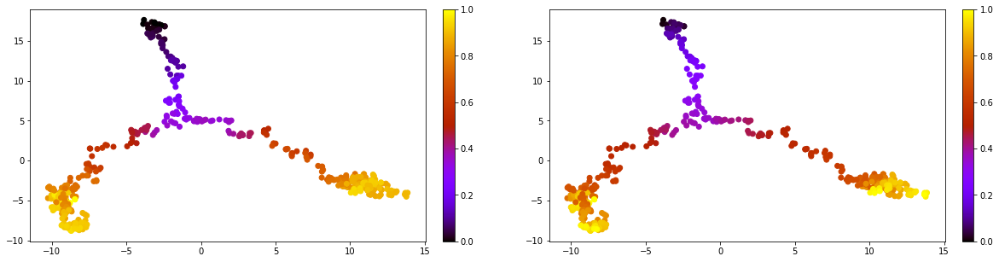

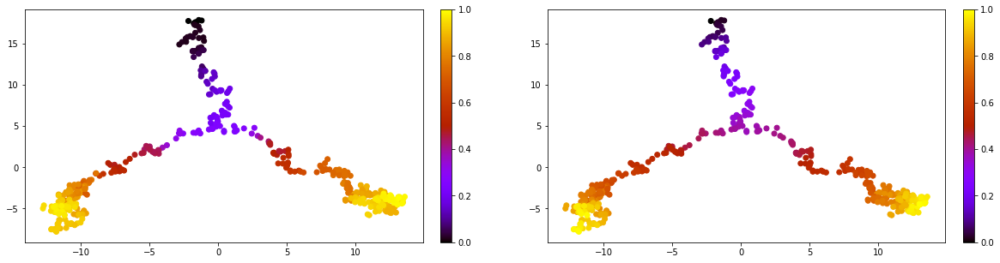

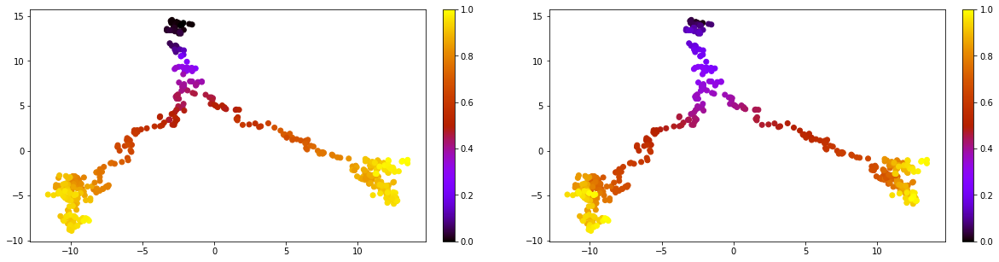

In [7]:
for idx, data in enumerate(DataLoader(dataTree[val_mask])):
    pt = data.y_dpt[0]
    X_pca = utils.pca_op(data.x.detach().numpy())
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

### velocity diffusion pseudo-time

pearson corr: 0.5174271354627774 , kendall tau: 0.4693582852155092
pearson corr: 0.5978009012284149 , kendall tau: 0.6078061485116965
pearson corr: 0.6107984586890958 , kendall tau: 0.6151219967814682
pearson corr: 0.6722985746202348 , kendall tau: 0.5720426697137609
pearson corr: 0.5818945767593099 , kendall tau: 0.6061701293800611
pearson corr: 0.6211357194049305 , kendall tau: 0.641511166661503
pearson corr: 0.720030720881679 , kendall tau: 0.6266876452942407
pearson corr: 0.6803476523412237 , kendall tau: 0.6156189745688939
pearson corr: 0.6631566267018878 , kendall tau: 0.6154745062187628
pearson corr: 0.6948479657881161 , kendall tau: 0.6095931288109881


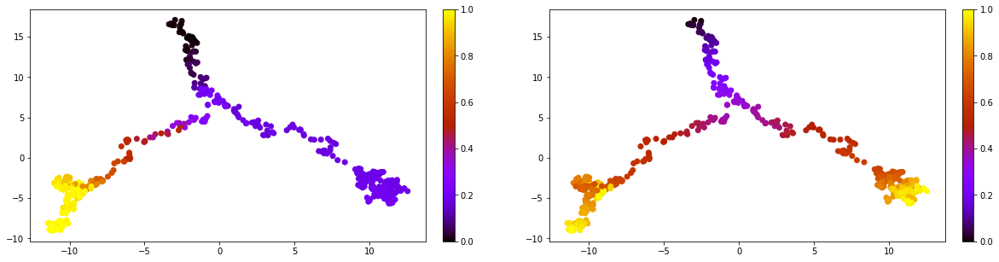

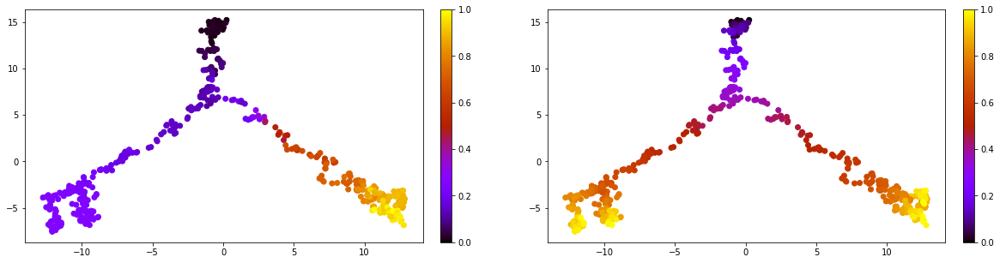

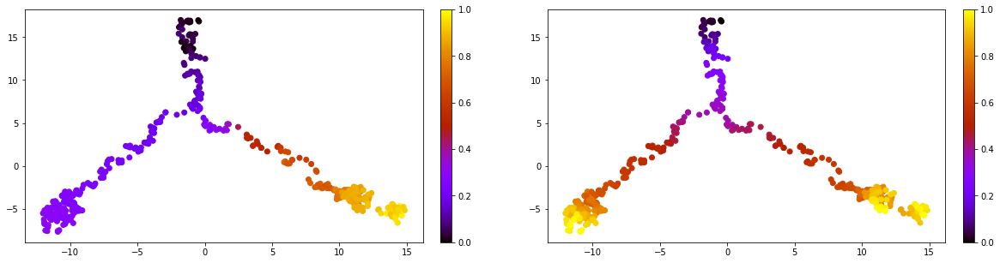

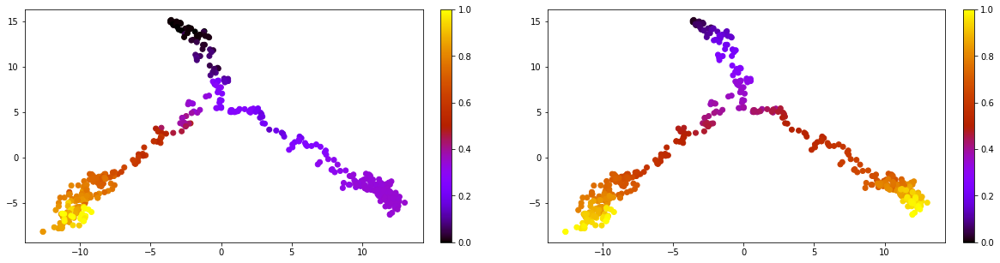

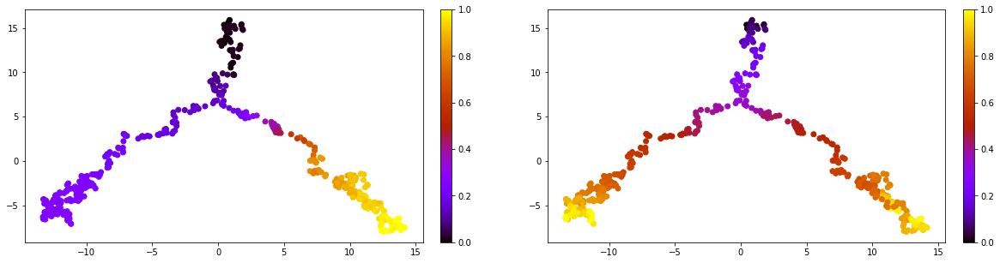

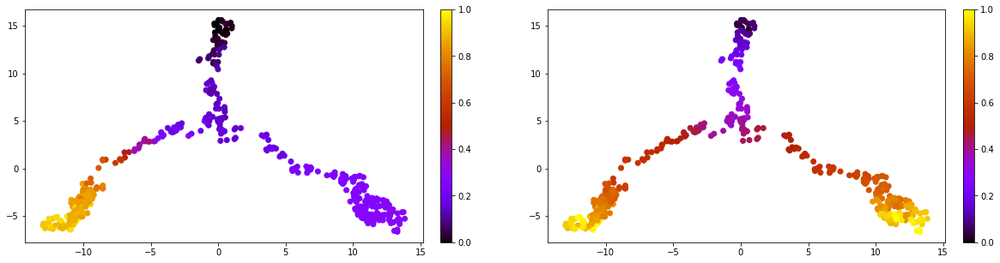

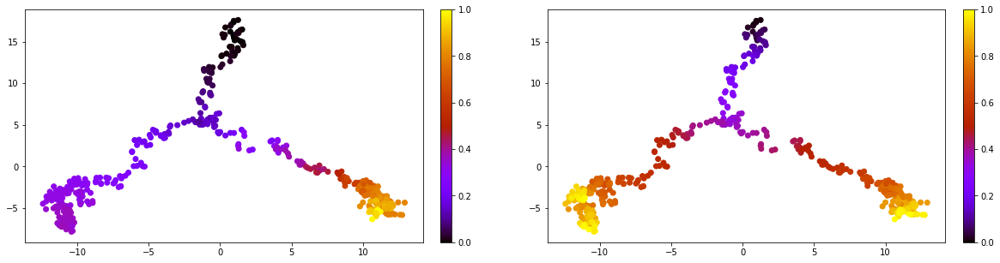

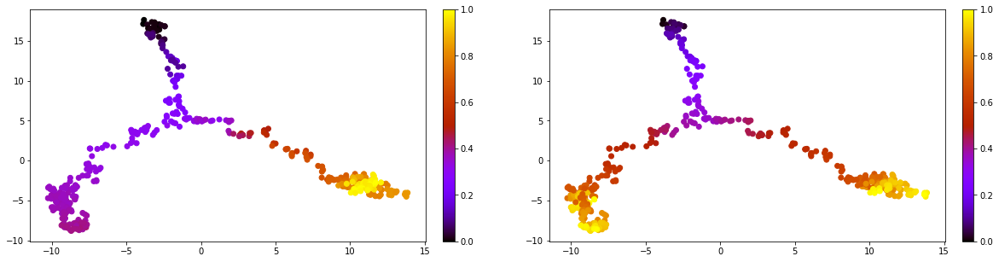

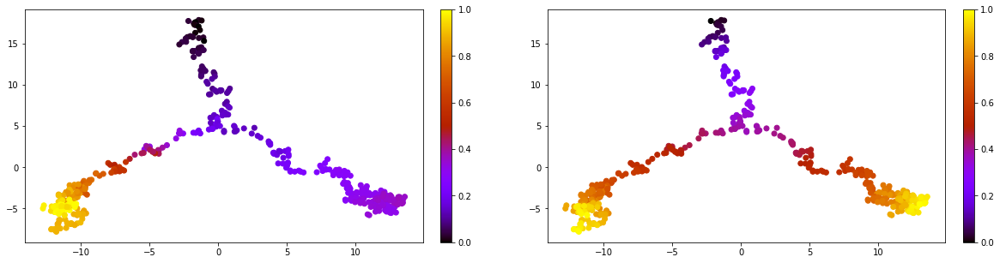

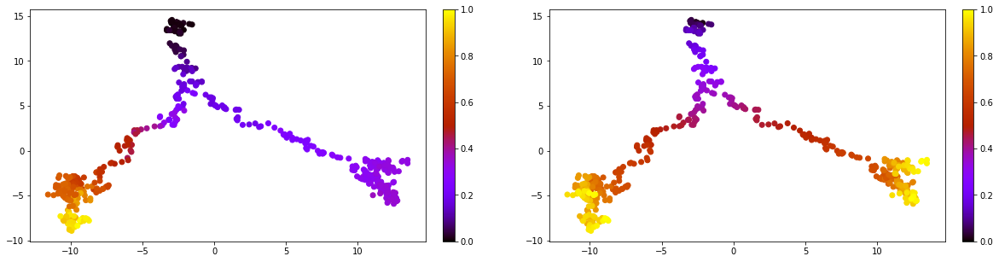

In [8]:
for idx, data in enumerate(DataLoader(dataTree[val_mask])):
    pt = data.y_vdpt[0]
    X_pca = utils.pca_op(data.x.detach().numpy())
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

### Diffusion NN

pearson corr: 0.9317867 , kendall tau: 0.6956053587079004
pearson corr: 0.9426054 , kendall tau: 0.7666875339092694
pearson corr: 0.9689595 , kendall tau: 0.8376361587579818
pearson corr: 0.95328045 , kendall tau: 0.7999749593088771
pearson corr: 0.96897537 , kendall tau: 0.8167355285672552
pearson corr: 0.9610596 , kendall tau: 0.8256500146070699
pearson corr: 0.90170306 , kendall tau: 0.7276908309336004
pearson corr: 0.9641866 , kendall tau: 0.8026960477442512
pearson corr: 0.9717959 , kendall tau: 0.8752472768248405
pearson corr: 0.9546358 , kendall tau: 0.7558031801677727


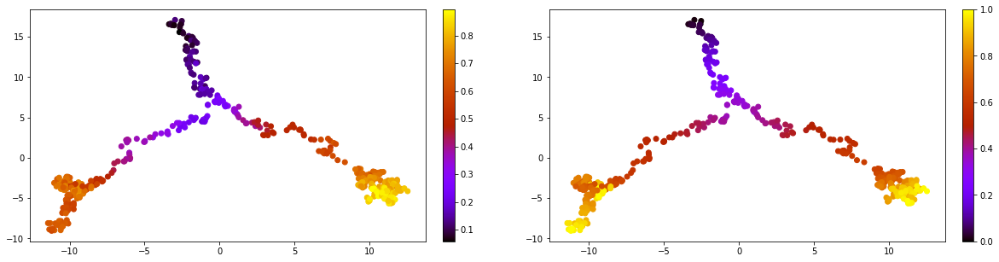

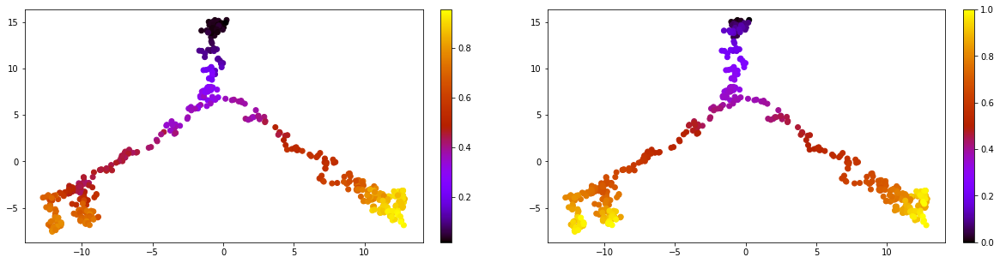

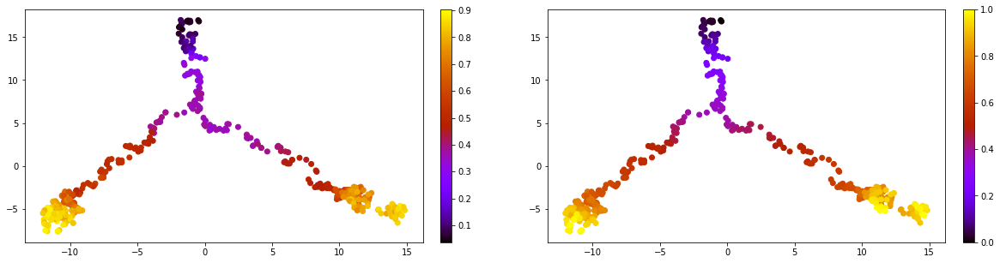

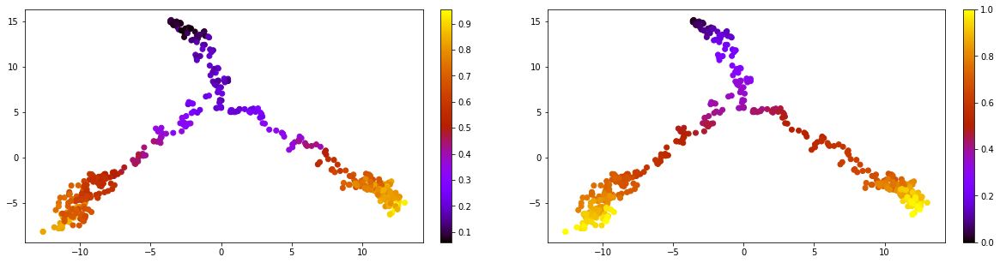

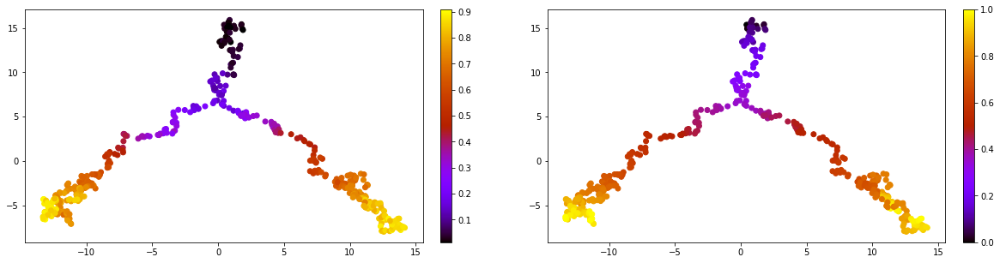

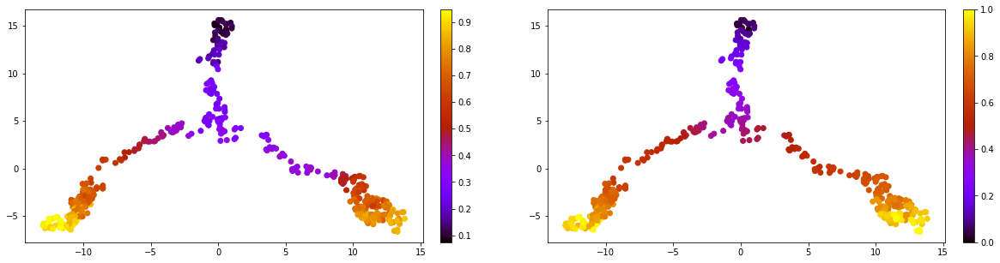

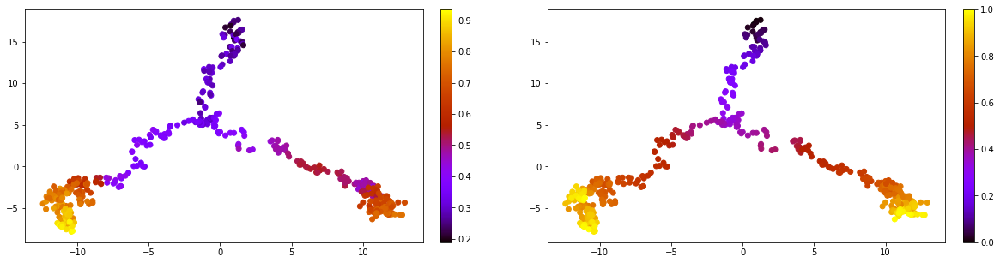

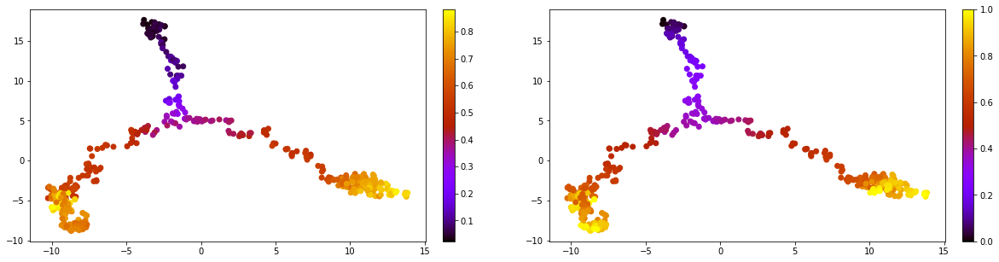

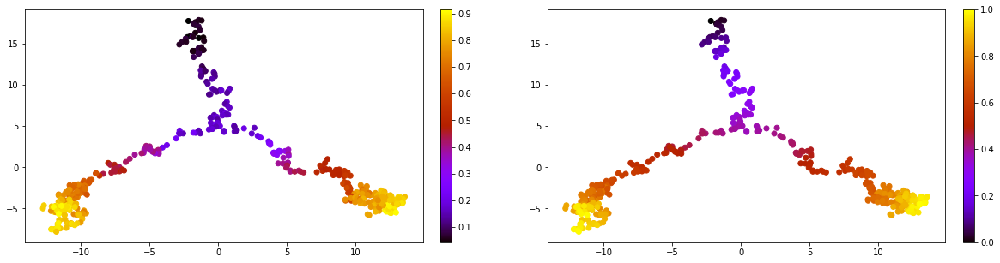

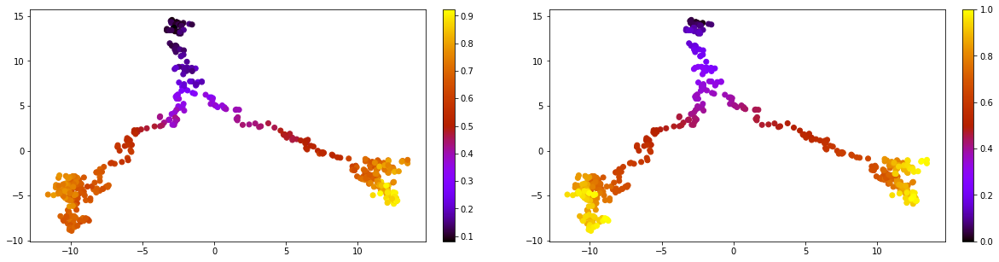

In [7]:
for idx, data in enumerate(DataLoader(dataTree[val_mask])):
    X_pca = utils.pca_op(data.x.detach().numpy(), standardize=False)

    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().reshape(-1)
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

## Noisy data
DPT with ground truth root cell outperform the GNN, so we use velocity DPT without ground truth root cell for fareness

pearson corr: -0.05474083999941431 , kendall tau: 0.018638621092608824
pearson corr: 0.008779502635782385 , kendall tau: -0.011543758607737573
pearson corr: -0.07238964843001418 , kendall tau: 0.001343850423605025
pearson corr: -0.08985786013552625 , kendall tau: -0.25475564458912403
pearson corr: -0.11783333871696057 , kendall tau: -0.25983998931819013
pearson corr: 0.569953492593582 , kendall tau: 0.607679145277743
pearson corr: 0.12314272191454682 , kendall tau: -0.009674053670547973
pearson corr: -0.032671776732814725 , kendall tau: -0.007837736321522475
pearson corr: -0.03808294184498112 , kendall tau: 0.010041317140353074
pearson corr: 0.07552392907137828 , kendall tau: 0.001994908392804975


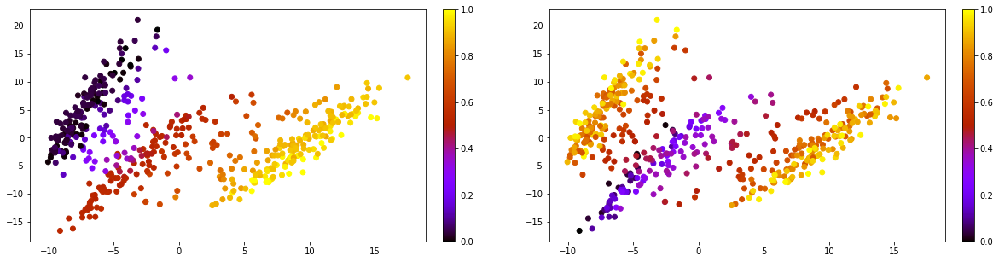

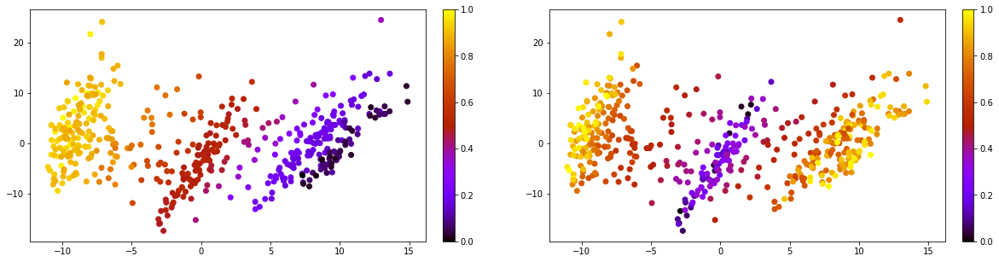

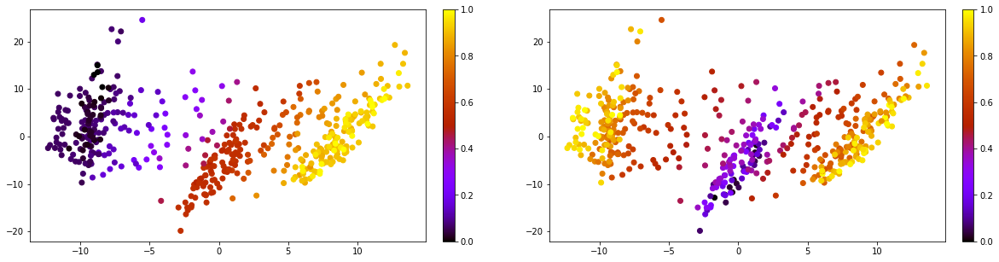

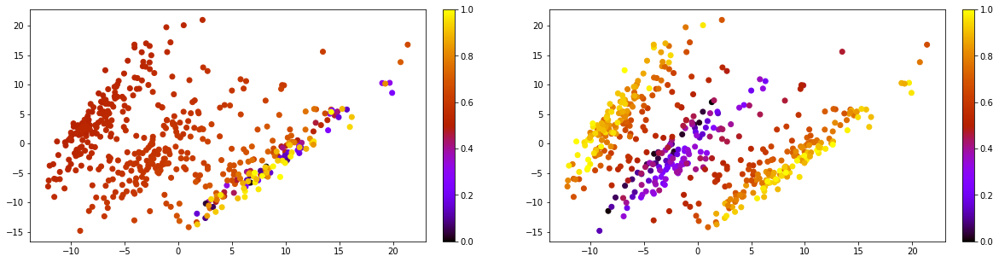

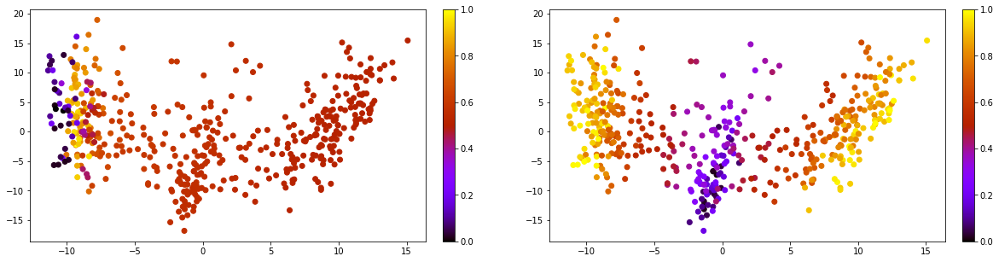

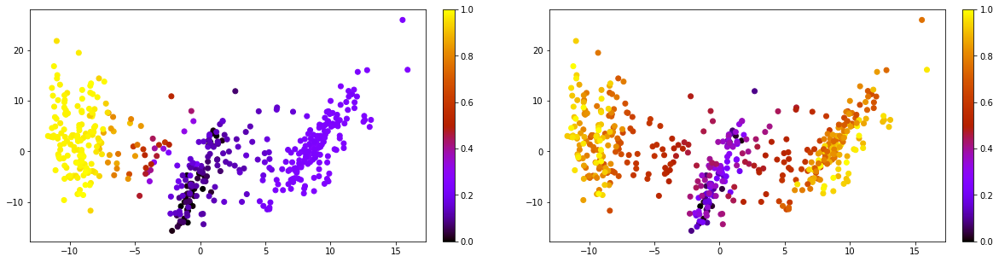

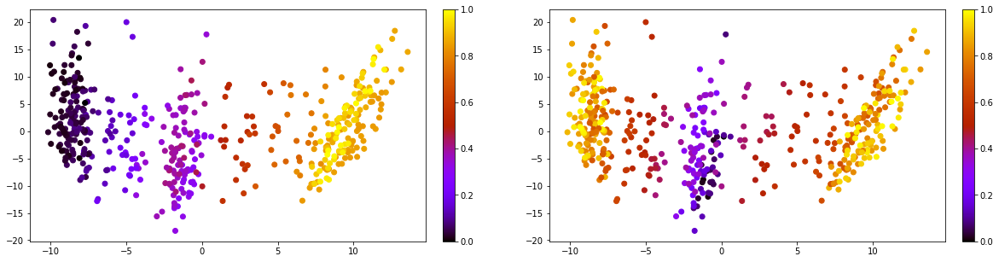

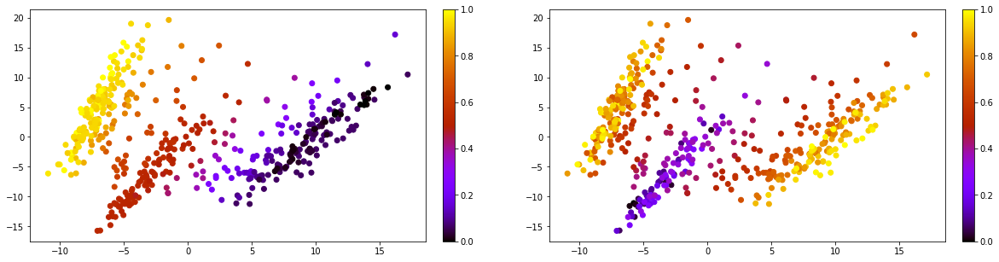

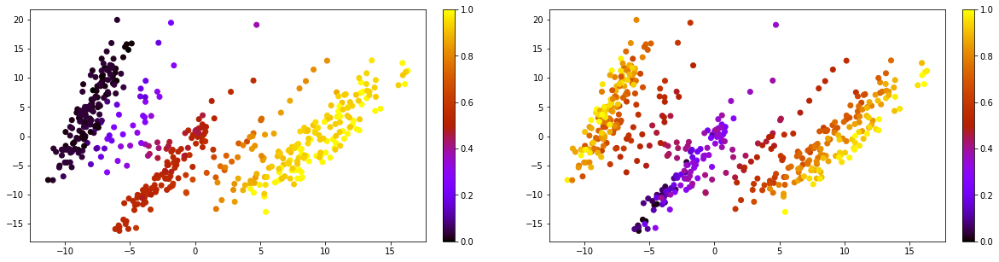

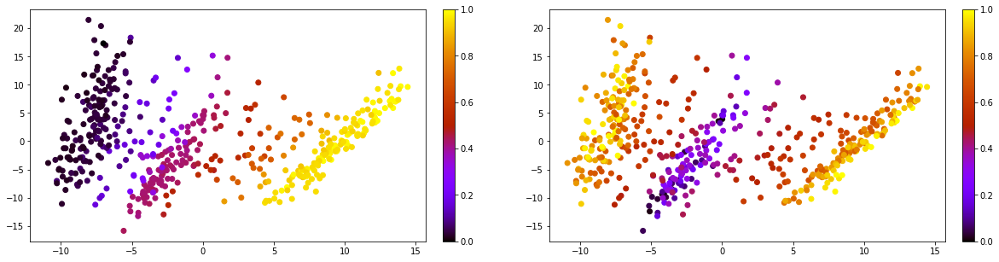

In [15]:
for idx, data in enumerate(DataLoader(dataTreeNoisy[val_mask])):
    pt = data.y_vdpt[0]
    X_pca = utils.pca_op(data.x.detach().numpy())
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

### Diffusion NN

pearson corr: 0.78256506 , kendall tau: 0.5123408872751555
pearson corr: 0.7748187 , kendall tau: 0.549568048078127
pearson corr: 0.62355626 , kendall tau: 0.41513292433537835
pearson corr: 0.58013064 , kendall tau: 0.40087642418930763
pearson corr: 0.8322681 , kendall tau: 0.5648261758691207
pearson corr: 0.7999572 , kendall tau: 0.535545261049205
pearson corr: 0.6865085 , kendall tau: 0.4821585075748091
pearson corr: 0.71053153 , kendall tau: 0.41064229372730693
pearson corr: 0.7922874 , kendall tau: 0.5192354242310421
pearson corr: 0.729878 , kendall tau: 0.49496264763574144


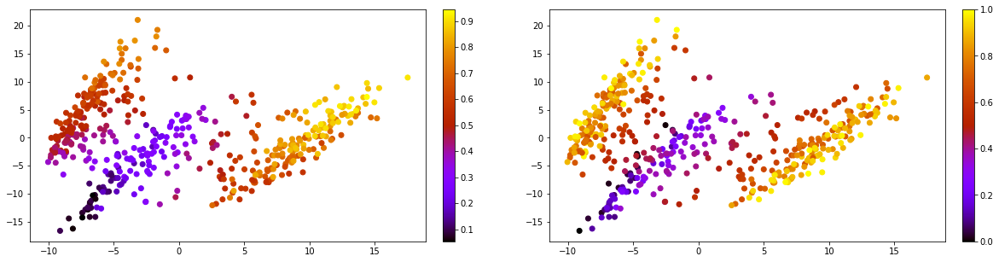

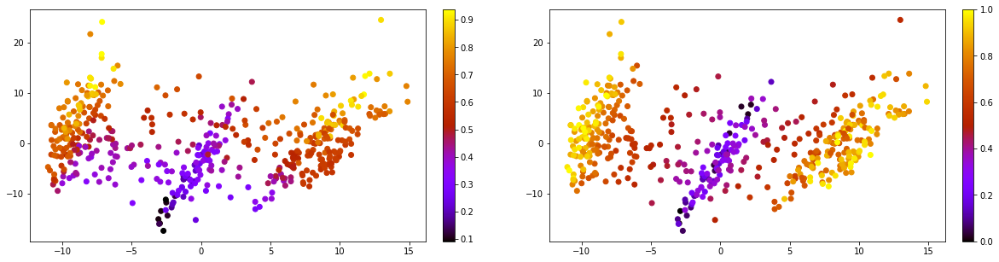

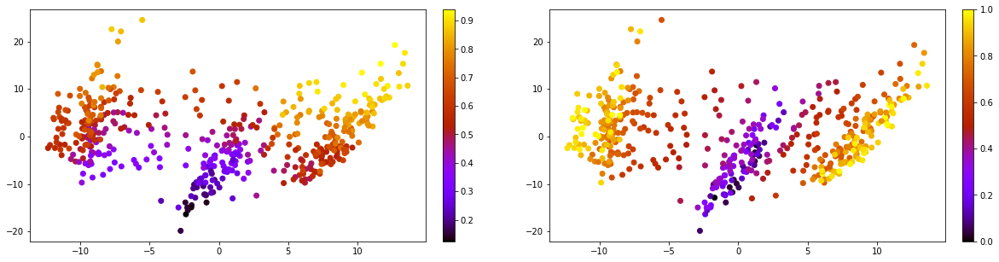

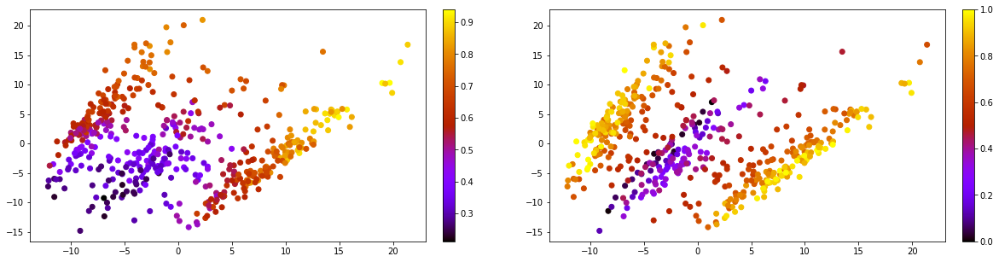

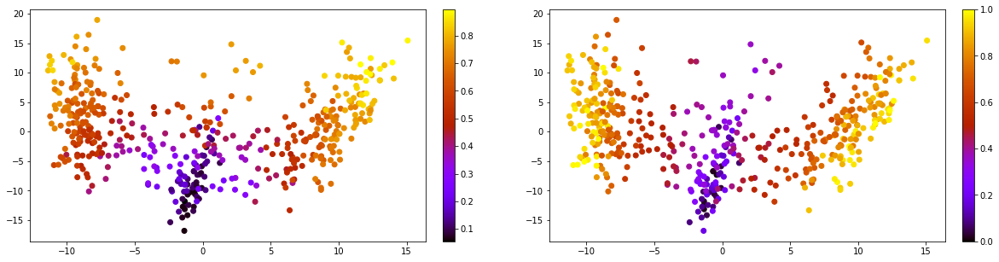

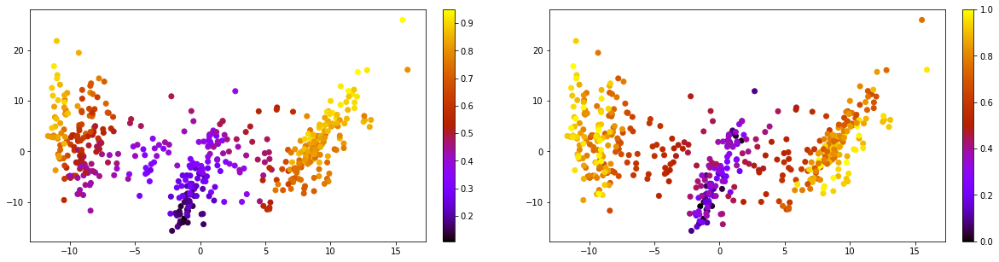

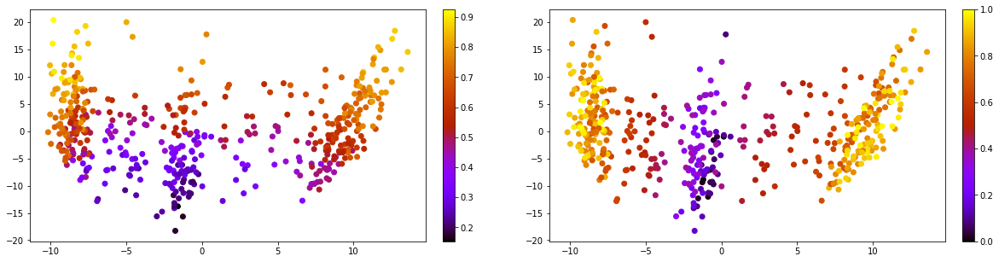

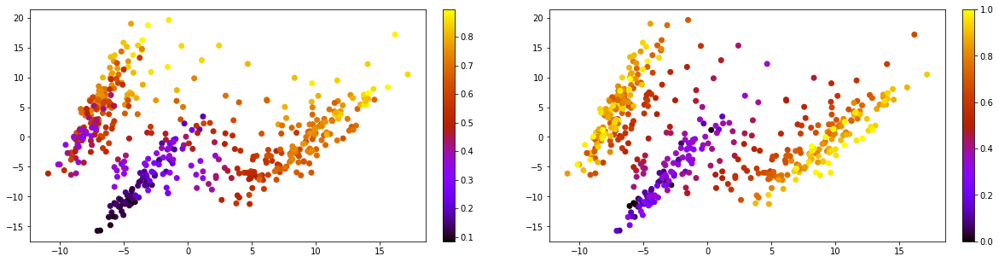

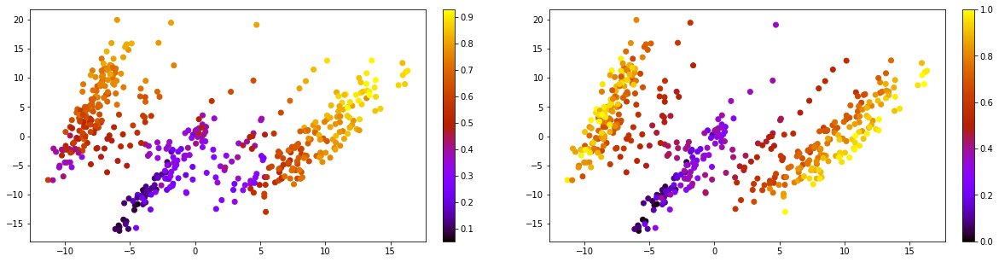

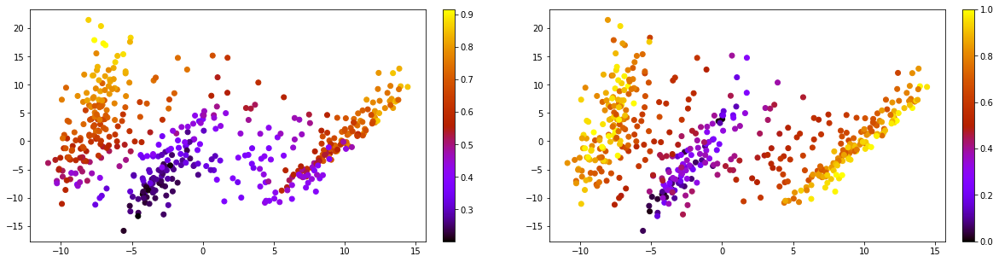

In [8]:
for idx, data in enumerate(DataLoader(dataTreeNoisy[val_mask])):
    X_pca = utils.pca_op(data.x.detach().numpy(), standardize=False)

    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().reshape(-1)
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

pearson corr: 0.92616934 , kendall tau: 0.7152372605483912
pearson corr: 0.9401126 , kendall tau: 0.7287425399607697
pearson corr: 0.90697694 , kendall tau: 0.6853553691415217
pearson corr: 0.971047 , kendall tau: 0.8829765034848295
pearson corr: 0.9699134 , kendall tau: 0.8301239514210593
pearson corr: 0.88934296 , kendall tau: 0.711163974792371
pearson corr: 0.88995427 , kendall tau: 0.7066566503902175
pearson corr: 0.96857005 , kendall tau: 0.7999081841325488
pearson corr: 0.9596776 , kendall tau: 0.7798255498518427
pearson corr: 0.9445648 , kendall tau: 0.7480071783314554


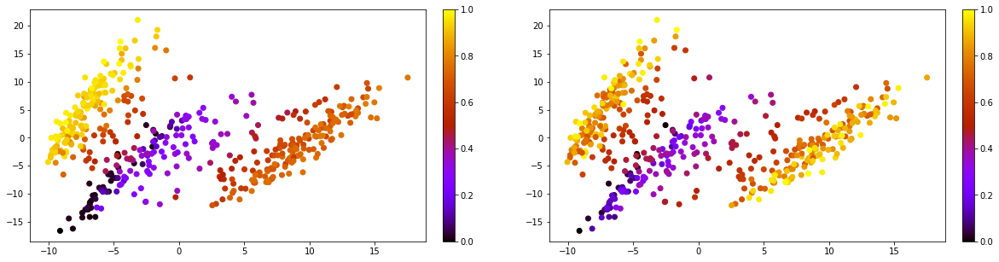

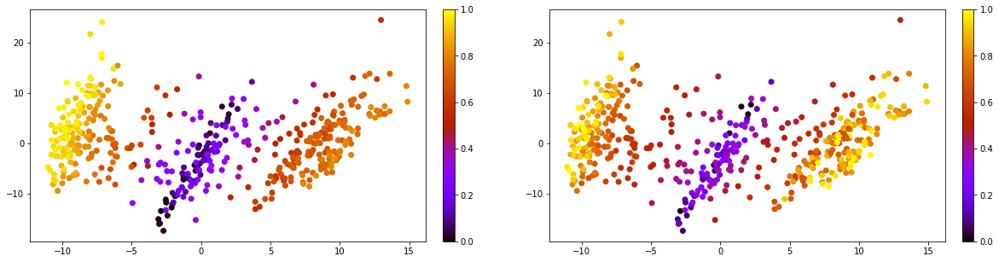

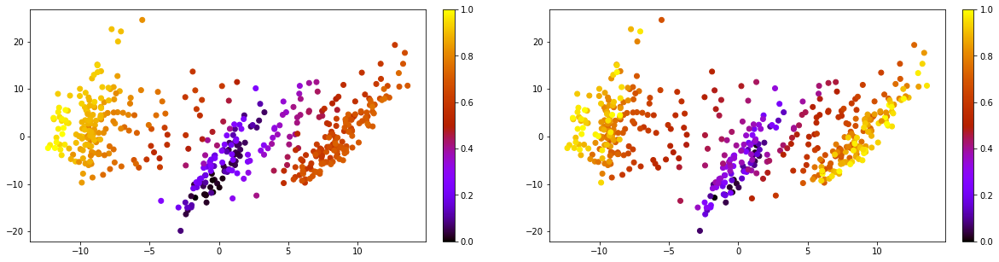

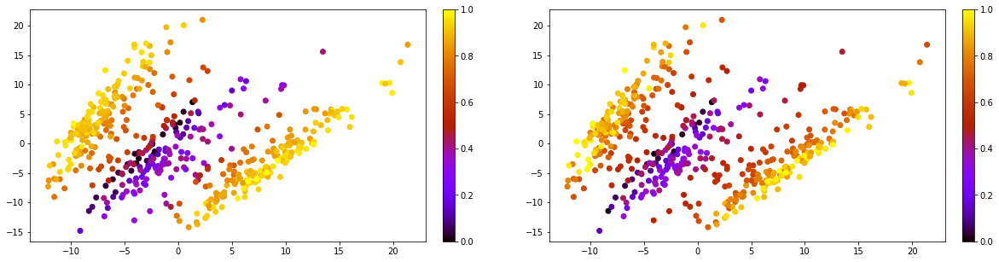

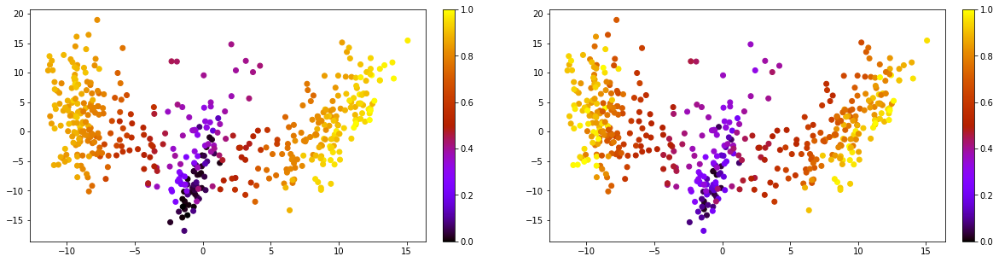

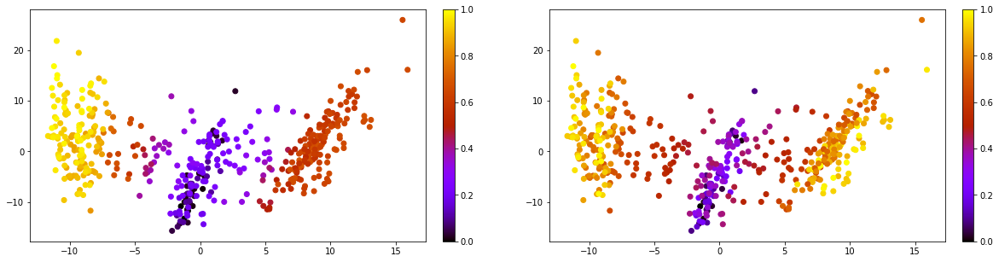

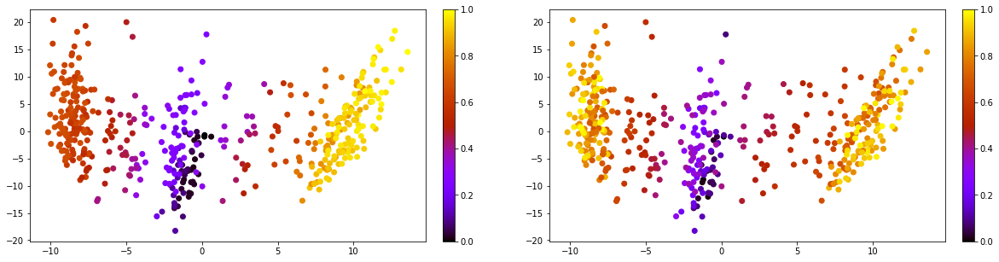

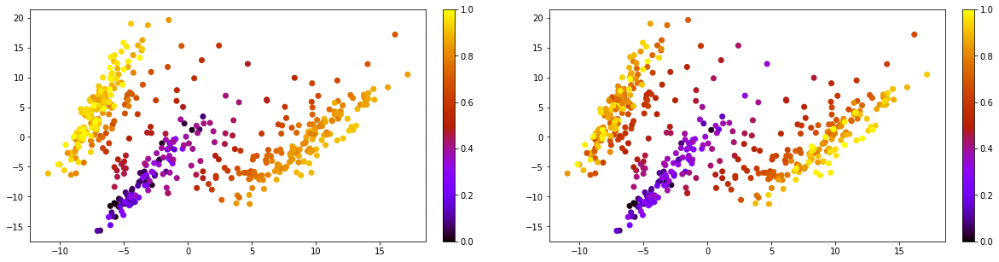

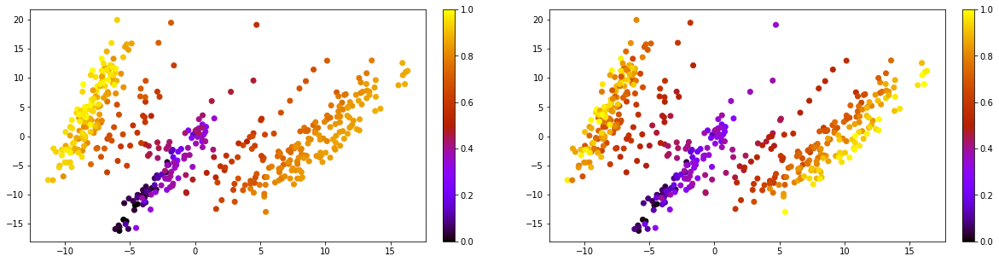

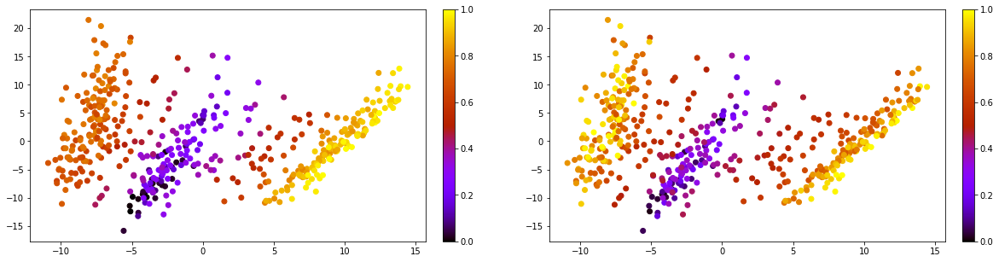

In [17]:
for idx, data in enumerate(DataLoader(dataTreeNoisy[val_mask])):
    pt = data.y_dpt[0]
    X_pca = utils.pca_op(data.x.detach().numpy())
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

In [16]:
# diffusion pseudo-time
pearsons = []
kts = []
for idx, data in enumerate(DataLoader(dataTree[val_mask])):
    adata = data.adata[0].copy()
    pt = adata.obs['dpt_pseudotime'].to_numpy()
    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearsons.append(np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2))))
    kts.append(utils.kendalltau(pt, pt_true))
print('average pearson corr:',np.mean(pearsons),', average kendall tau:',np.mean(kts))

average pearson corr: 0.9478666 , average kendall tau: 0.8001986561495764


In [18]:
# model
pearsons = []
kts = []
for idx, data in enumerate(DataLoader(dataTree[val_mask])):
    pt,_,_ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().squeeze()
    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearsons.append(np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2))))
    kts.append(utils.kendalltau(pt, pt_true))
print('average pearson corr:',np.mean(pearsons),', average kendall tau:',np.mean(kts))

average pearson corr: 0.9516368 , average kendall tau: 0.8142765326989692


# Try with Dyngen
If start with 0 root cell, the result is exactly the opposite with dpt

pearson corr: 0.5523060875929359 , kendall tau: 0.4441321077890445
pearson corr: 0.6373351597891723 , kendall tau: 0.549616085647967
pearson corr: 0.4988651472711272 , kendall tau: 0.466651008103094
pearson corr: 0.5749942495019785 , kendall tau: 0.5915004729129811
pearson corr: 0.5943479080766153 , kendall tau: 0.550414559226291
pearson corr: 0.7049703351096529 , kendall tau: 0.6393261045245701
pearson corr: 0.6284612745263319 , kendall tau: 0.659408095566887
pearson corr: 0.6550656331603393 , kendall tau: 0.665544932336032
pearson corr: 0.5913380371995136 , kendall tau: 0.6053113509955357
pearson corr: 0.6223673427090742 , kendall tau: 0.5943576858754891
pearson corr: 0.5845372263652632 , kendall tau: 0.6127449779886313


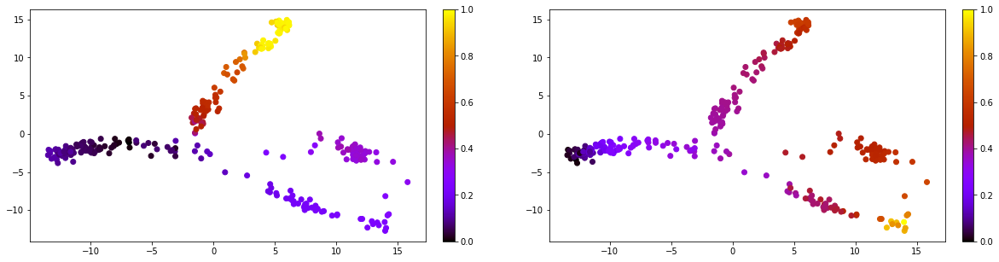

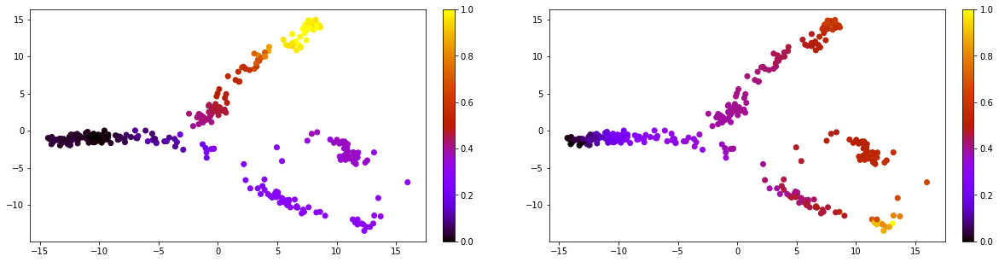

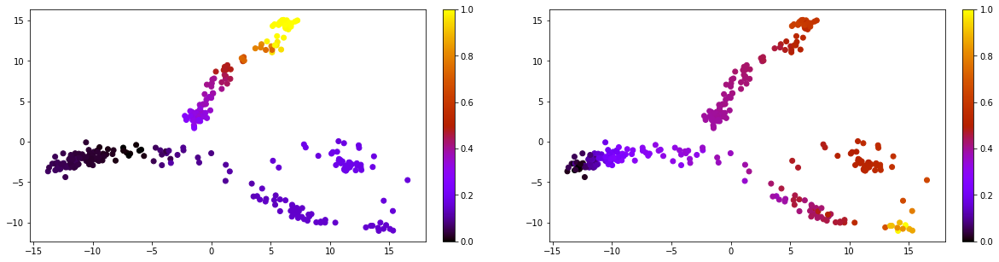

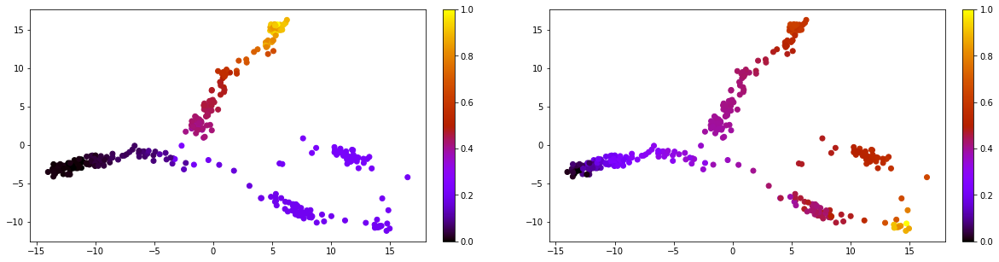

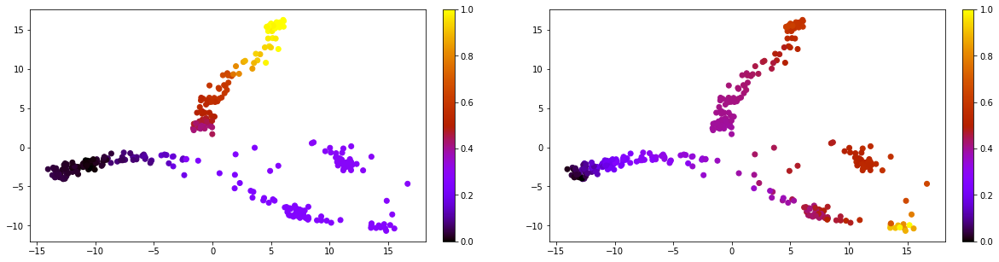

...

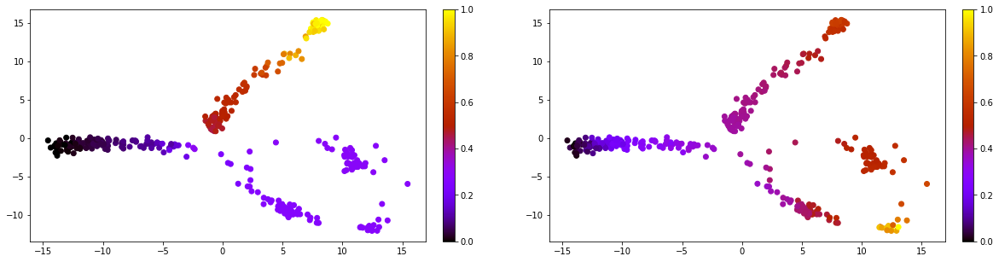

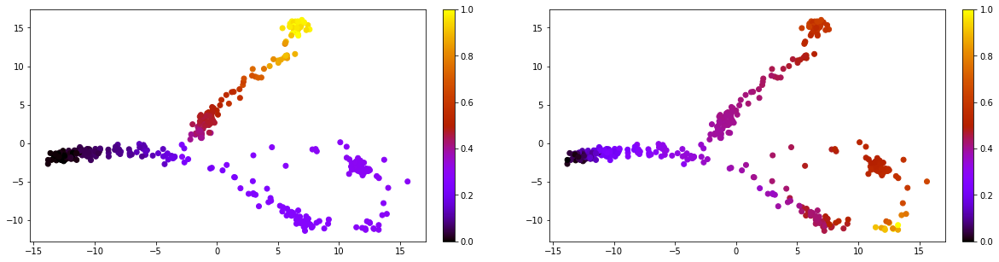

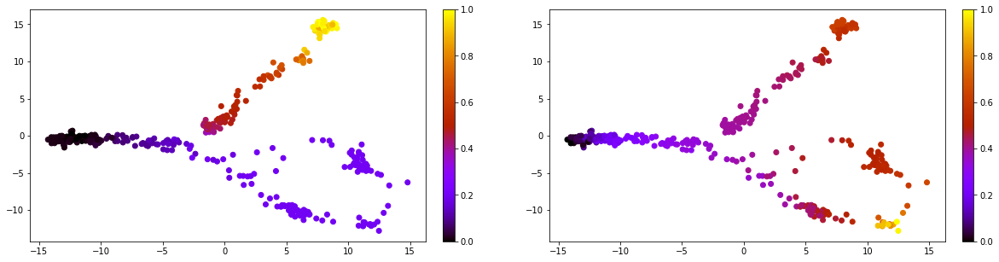

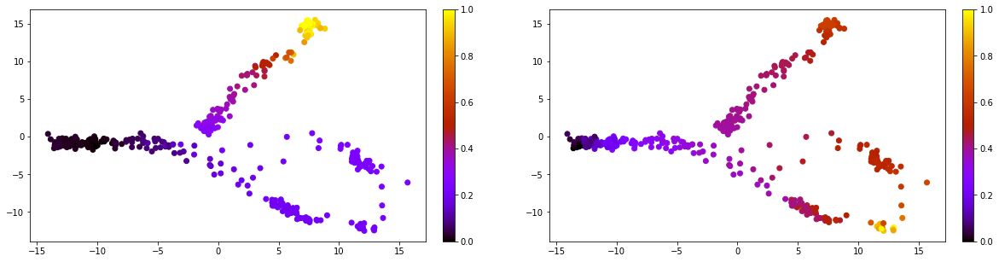

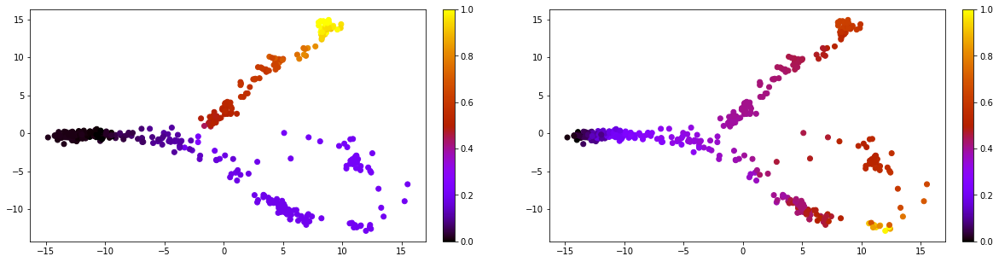

In [9]:
for idx, data in enumerate(DataLoader(dataDyngen)):
    pt = data.y_vdpt[0]
    X_pca = utils.pca_op(data.x.detach().numpy())
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

pearson corr: -0.8978209 , kendall tau: -0.7790506767925818
pearson corr: -0.9072847 , kendall tau: -0.8097593465928682
pearson corr: -0.8605212 , kendall tau: -0.6808810664394103
pearson corr: -0.93197095 , kendall tau: -0.8696763656318924
pearson corr: -0.9145395 , kendall tau: -0.8377957210804922
pearson corr: -0.9024186 , kendall tau: -0.8281895229138908
pearson corr: -0.8806155 , kendall tau: -0.740521377131371
pearson corr: -0.8274452 , kendall tau: -0.6369928728848877
pearson corr: -0.82992727 , kendall tau: -0.7752003208045547
pearson corr: -0.8954678 , kendall tau: -0.80180963685861
pearson corr: -0.8055468 , kendall tau: -0.687900982694831


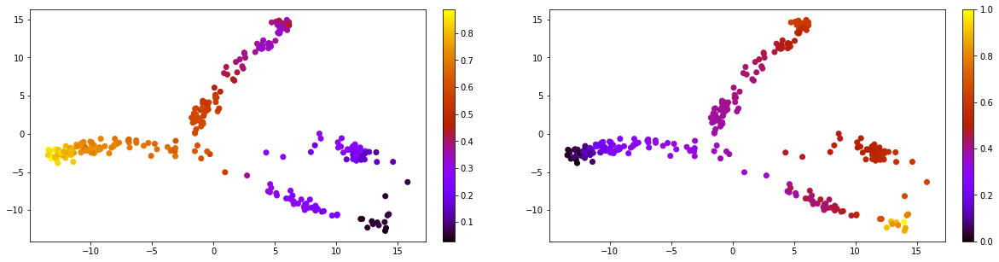

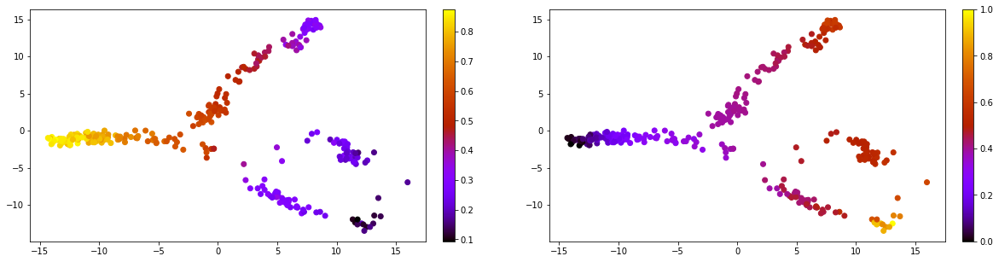

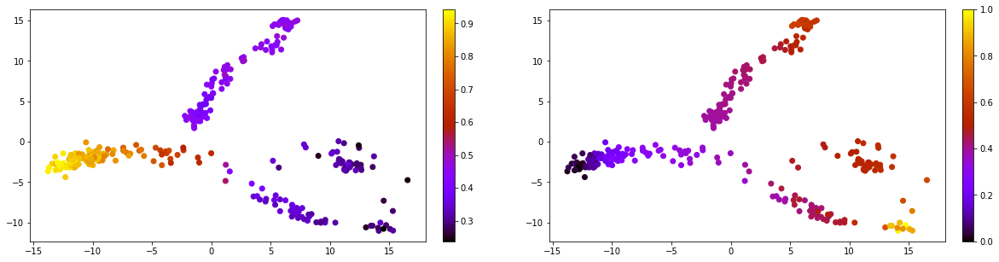

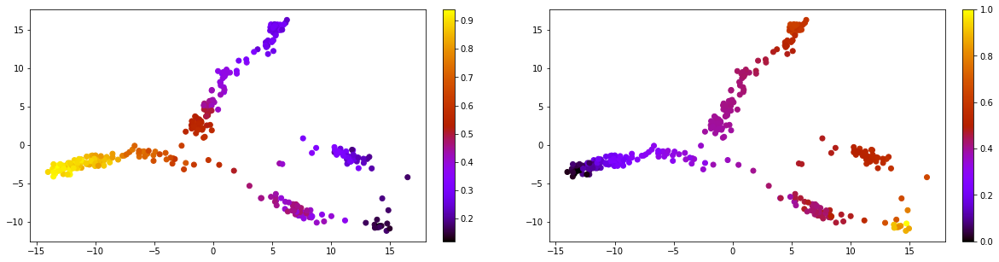

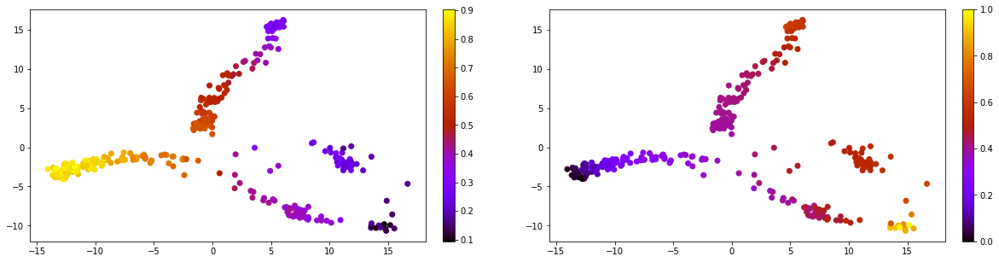

...

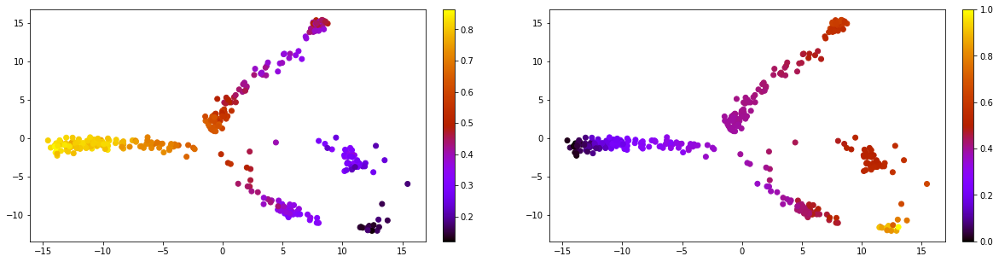

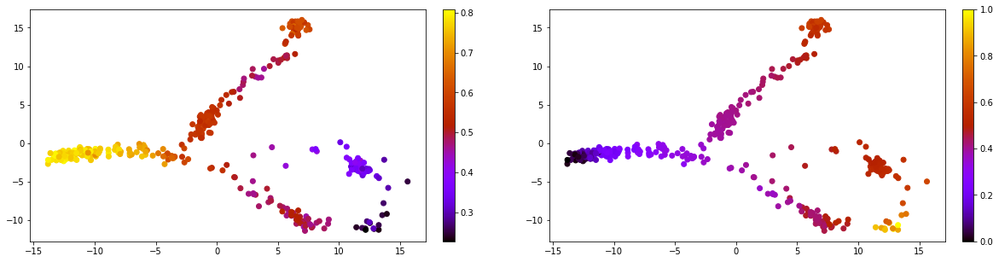

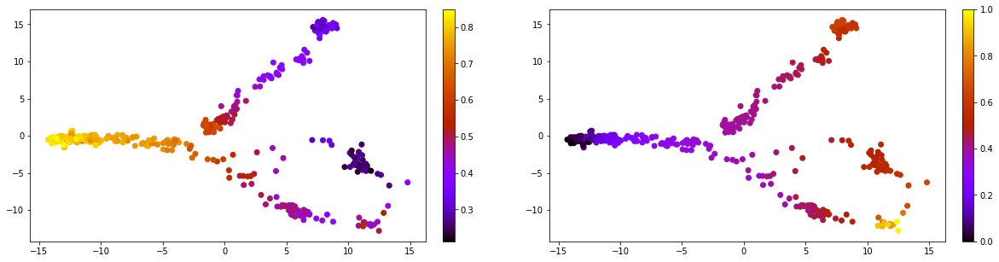

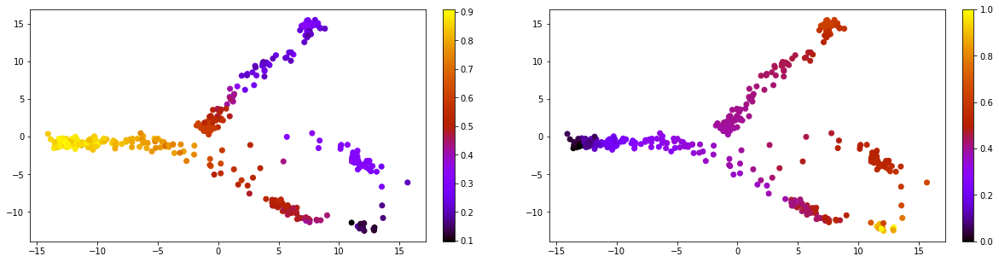

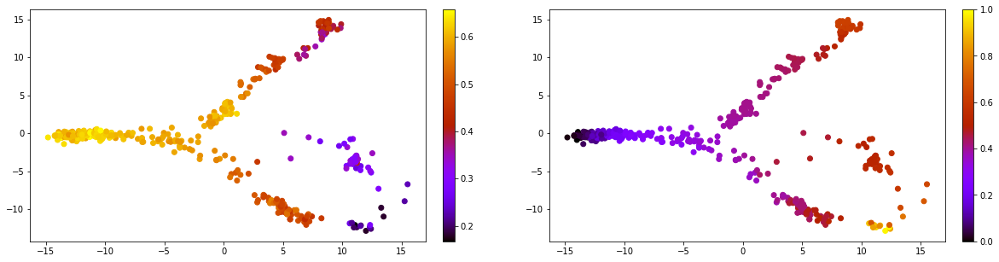

In [14]:
for idx, data in enumerate(DataLoader(dataDyngen)):
    X_pca = utils.pca_op(data.x.detach().numpy(), standardize=False)

    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().reshape(-1)
    fig = plt.figure(figsize = (20, 5))
    ax1, ax2 = fig.subplots(1,2)
    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt_true = data.y.cpu().numpy().squeeze()
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt_true, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)

    vx = pt - np.mean(pt)
    vy = pt_true - np.mean(pt_true)
    pearson = np.sum(vx * vy) / (np.sqrt(np.sum(vx ** 2)) * np.sqrt(np.sum(vy ** 2)))
    kt = utils.kendalltau(pt, pt_true)
    print('pearson corr:',pearson,', kendall tau:',kt)

# Real dataset

(1720, 1448)
(1720, 1448)
Transforming to str index.
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
(1720, 1448)
computing velocity graph
... 100%    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


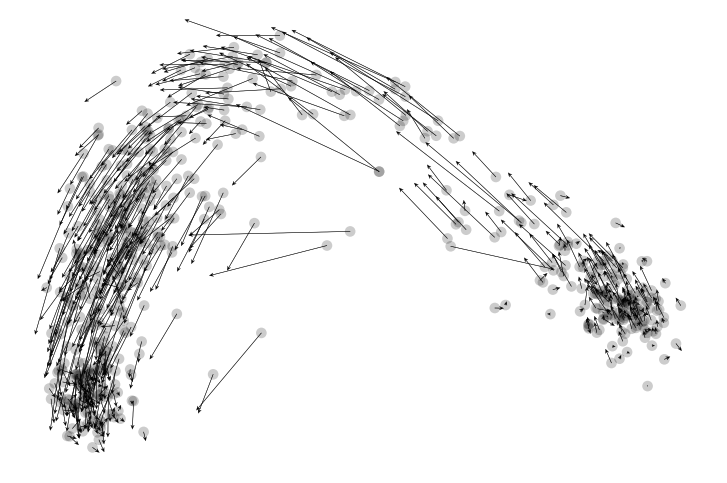

In [12]:
root = './data/real_dataset/linear/'

data_list = []

path = root

df = pd.read_csv(path + "unspliced.csv")
df = df.drop(df.columns[[0]], axis=1)
X_unspliced = df.to_numpy().T
print(X_unspliced.shape)

df = pd.read_csv(path + "spliced.csv")
df = df.drop(df.columns[[0]], axis=1)
X_spliced = df.to_numpy().T
print(X_unspliced.shape)

df = pd.read_csv(path + "velocity.csv")
df = df.drop(df.columns[[0]], axis=1)
velo_matrix = df.to_numpy().T

X_obs = pd.read_csv(path + "cell_info.csv")

adata = anndata.AnnData(X = csr_matrix(X_spliced),
                obs = X_obs,
                layers = dict(
                    unspliced = csr_matrix(X_unspliced),
                    spliced = csr_matrix(X_spliced),
                ))

scv.pp.filter_and_normalize(adata, min_shared_counts=0, n_top_genes=305)
adata = adata[::3,:300]

# compute velocity
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
scv.tl.velocity(adata, mode='stochastic') 

print(velo_matrix.shape)
# adata.layers['velocity'] = velo_matrix

velo_matrix = adata.layers["velocity"].copy()
scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding(adata, color = ['0'],  dpi = 150, arrow_length=10)

In [13]:
adata

AnnData object with n_obs × n_vars = 574 × 300 
    obs: 'Unnamed: 0', '0', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition'
    var: 'means', 'dispersions', 'dispersions_norm', 'velocity_gamma', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_settings', 'velocity_graph', 'velocity_graph_neg', '0_colors'
    obsm: 'X_pca', 'velocity_pca'
    varm: 'PCs'
    layers: 'unspliced', 'spliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'

574


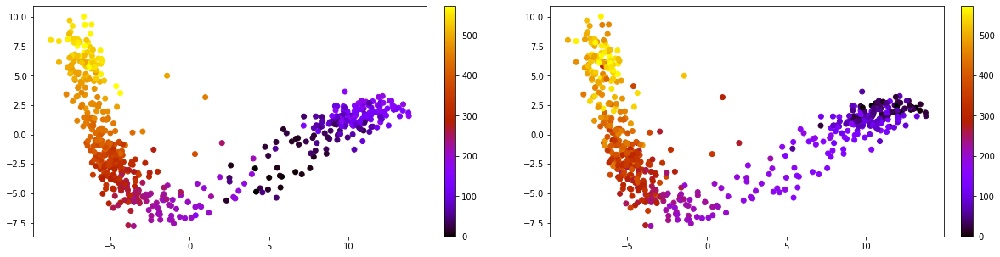

In [14]:
for idx, data in enumerate(DataLoader(dataReal)):
    pt = data.y_vdpt[0].squeeze()

    # pt = np.argsort(pt)
    X_pca = utils.pca_op(data.x.detach().numpy(), standardize=False)
    fig = plt.figure(figsize = (20, 5))
    ax1,ax2 = fig.subplots(1,2)
    
    pred_sorted = sorted(pt)
    pt = [pred_sorted.index(i) for i in pt]

    pseudo_visual = ax1.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax1)

    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().numpy().squeeze()

    pred_sorted = sorted(pt)
    pt = [pred_sorted.index(i) for i in pt]
    # pt = (pt - np.min(pt))/(np.max(pt)-np.min(pt))
    # print(len(pt))
    # pt = np.argsort(pt)
    
    pseudo_visual = ax2.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax2)    

    

(490, 300)
(490, 300)
Transforming to str index.
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
(490, 300)
computing velocity graph
... 100%    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


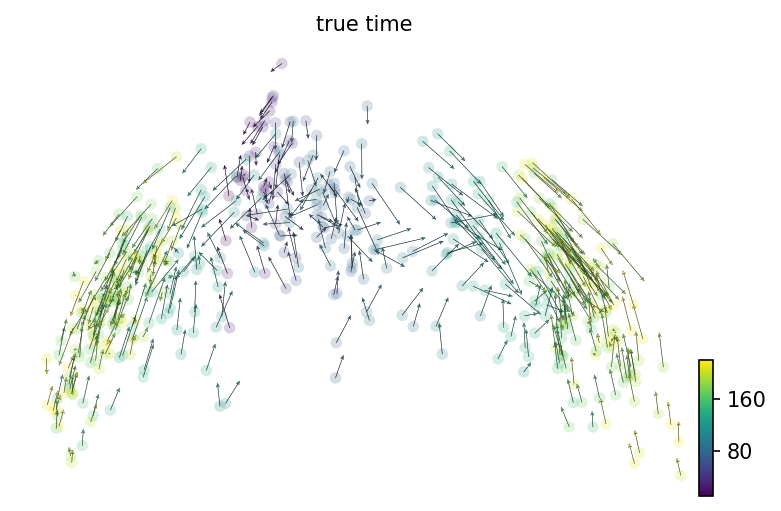

In [110]:
from symsimDataset import technological_noise
# root = './data/symsim/bifur/branch51/'
root = './data/symsim/tree/rand1/'
 
data_list = []

path = root

df = pd.read_csv(path + "unspliced_counts.txt", header=None, sep='\t')
# df = df.drop(df.columns[[0]], axis=1)
X_unspliced = df.to_numpy().T
print(X_unspliced.shape)
X_unspliced = technological_noise(X_unspliced, capture_rate=0.2)
df = pd.read_csv(path + "spliced_counts.txt", header=None, sep='\t')
# df = df.drop(df.columns[[0]], axis=1)
X_spliced = df.to_numpy().T
print(X_unspliced.shape)
X_spliced = technological_noise(X_spliced, capture_rate=0.2)

X_obs = pd.read_csv(path + "cell_labels.txt", sep = '\t')
# df = df.drop(df.columns[[0]], axis=1)
# velo_matrix = df.to_numpy().T

# X_obs = pd.read_csv(path + "cell_info.csv")

adata = anndata.AnnData(X = csr_matrix(X_spliced),
                obs = X_obs,
                layers = dict(
                    unspliced = csr_matrix(X_unspliced),
                    spliced = csr_matrix(X_spliced),
                ))

scv.pp.filter_and_normalize(adata, min_shared_counts=0, n_top_genes=305)
adata = adata[:,:300]

# compute velocity
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
scv.tl.velocity(adata, mode='stochastic') 

print(velo_matrix.shape)
# adata.layers['velocity'] = velo_matrix

velo_matrix = adata.layers["velocity"].copy()
scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding(adata, color = ['true_time'],  dpi = 150, arrow_length=10)

In [109]:
adata

AnnData object with n_obs × n_vars = 490 × 300 
    obs: 'pop', 'true_time', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition'
    var: 'velocity_gamma', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_settings', 'velocity_graph', 'velocity_graph_neg'
    obsm: 'X_pca', 'velocity_pca'
    varm: 'PCs'
    layers: 'unspliced', 'spliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'